In [1]:
!pip install tflite-model-maker pycocotools

In [1]:
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
import numpy as np
import os

from tflite_model_maker.config import ExportFormat
from tflite_model_maker import model_spec
from tflite_model_maker import object_detector

import tensorflow as tf
assert tf.__version__.startswith('2')

tf.get_logger().setLevel('ERROR')
from absl import logging
logging.set_verbosity(logging.ERROR)

2021-08-21 13:23:50.344283: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0


In [13]:
from os import walk
from PIL import Image, ImageDraw, ImageFont

In [17]:
# Load the labels into a list
classes = ["0.01", "0.02", "0.05", "0.1", "0.2", "0.5", "1", "2"] 

# model.model_spec.config.num_classes

# Define a list of colors for visualization
COLORS = np.random.randint(0, 255, size=(len(classes), 3), dtype=np.uint8)

In [5]:


def preprocess_image(image_path, input_size):
    """Preprocess the input image to feed to the TFLite model"""
    img = tf.io.read_file(image_path)
    img = tf.io.decode_image(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.uint8)
    original_image = img
    resized_img = tf.image.resize(img, input_size)
    resized_img = resized_img[tf.newaxis, :]
    return resized_img, original_image


def set_input_tensor(interpreter, image):
    """Set the input tensor."""
    tensor_index = interpreter.get_input_details()[0]['index']
    input_tensor = interpreter.tensor(tensor_index)()[0]
    input_tensor[:, :] = image


def get_output_tensor(interpreter, index):
    """Retur the output tensor at the given index."""
    output_details = interpreter.get_output_details()[index]
    tensor = np.squeeze(interpreter.get_tensor(output_details['index']))
    return tensor


def detect_objects(interpreter, image, threshold):
    """Returns a list of detection results, each a dictionary of object info."""
    # Feed the input image to the model
    set_input_tensor(interpreter, image)
    interpreter.invoke()

    # Get all outputs from the model
    boxes = get_output_tensor(interpreter, 0)
    classes = get_output_tensor(interpreter, 1)
    scores = get_output_tensor(interpreter, 2)
    count = int(get_output_tensor(interpreter, 3))

    results = []
    for i in range(count):
        if scores[i] >= threshold:
            result = {
            'bounding_box': boxes[i],
            'class_id': classes[i],
            'score': scores[i]
            }
            results.append(result)
    return results


def run_odt_and_draw_results(image_path, interpreter, threshold=0.5, draw=True):
    """Run object detection on the input image and draw the detection results"""
    # Load the input shape required by the model
    _, input_height, input_width, _ = interpreter.get_input_details()[0]['shape']

    # Load the input image and preprocess it
    preprocessed_image, original_image = preprocess_image(
      image_path,
      (input_height, input_width)
    )

    # Run object detection on the input image
    results = detect_objects(interpreter, preprocessed_image, threshold=threshold)
    
    # Plot the detection results on the input image
    original_image_np = original_image.numpy().astype(np.uint8)
    original_image_pil = Image.fromarray(original_image_np).copy()
    image_copy = Image.fromarray(original_image_np).copy()
    detected_coins = []
    for obj in results:
        # Convert the object bounding box from relative coordinates to absolute
        # coordinates based on the original image resolution
        ymin, xmin, ymax, xmax = obj['bounding_box']
        xmin = int(xmin * original_image_np.shape[1])
        xmax = int(xmax * original_image_np.shape[1])
        ymin = int(ymin * original_image_np.shape[0])
        ymax = int(ymax * original_image_np.shape[0])

        # Find the class index of the current object
        class_id = int(obj['class_id'])

        # Draw the bounding box and label on the image
        if draw:
            color = [int(c) for c in COLORS[class_id]]
            fnt = ImageFont.truetype("Pillow/Tests/fonts/FreeMono.ttf", 15)
            draw = ImageDraw.Draw(image_copy)
            draw.rectangle((xmin, ymin, xmax, ymax), outline ="red")
            # Make adjustments to make the label visible for all objects
            y = ymin - 15 if ymin - 15 > 15 else ymin + 15
            label = "{}: {:.0f}%".format(classes[class_id], obj['score'] * 100)
            draw.text((xmin, ymin), label, font=fnt, fill="red")
            
        # cut the coins
        detected_coins.append(original_image_pil.crop((xmin, ymin, xmax, ymax)))

    return image_copy, results, detected_coins


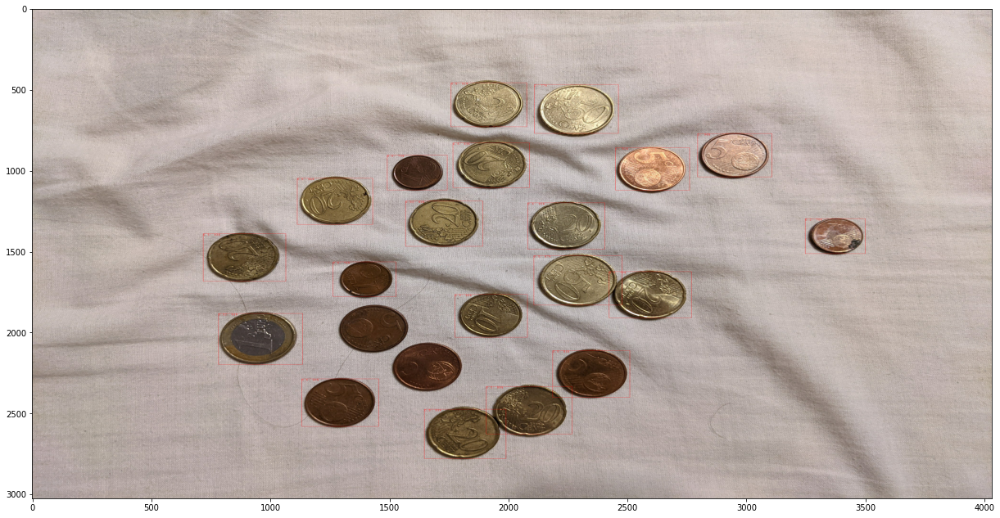

{'bounding_box': array([0.2545497 , 0.6936155 , 0.34293106, 0.77084213], dtype=float32), 'class_id': 6.0, 'score': 0.95703125}
1


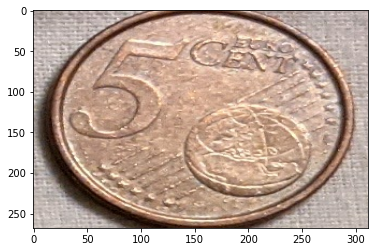

#########################
{'bounding_box': array([0.34566864, 0.2764132 , 0.4402177 , 0.35514283], dtype=float32), 'class_id': 5.0, 'score': 0.9375}
0.5


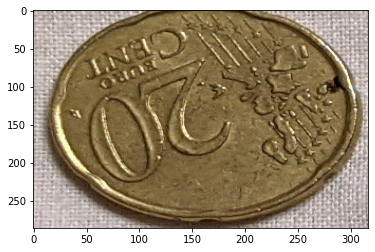

#########################
{'bounding_box': array([0.39603686, 0.51656026, 0.49055272, 0.5968502 ], dtype=float32), 'class_id': 5.0, 'score': 0.93359375}
0.5


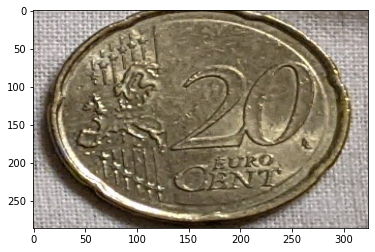

#########################
{'bounding_box': array([0.27354252, 0.43866965, 0.36536497, 0.51818955], dtype=float32), 'class_id': 5.0, 'score': 0.9296875}
0.5


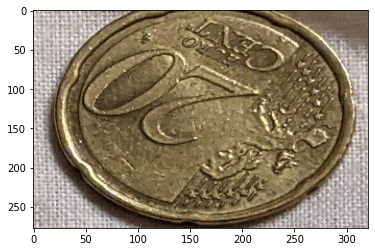

#########################
{'bounding_box': array([0.4591255 , 0.1785294 , 0.5564137 , 0.26442233], dtype=float32), 'class_id': 5.0, 'score': 0.92578125}
0.5


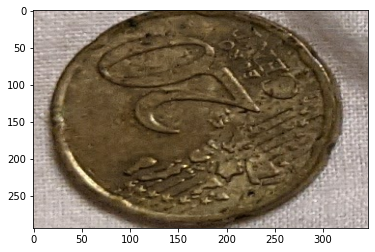

#########################
{'bounding_box': array([0.81783354, 0.4087662 , 0.9189452 , 0.4938354 ], dtype=float32), 'class_id': 5.0, 'score': 0.92578125}
0.5


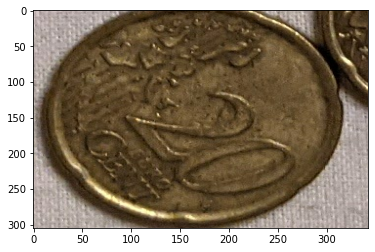

#########################
{'bounding_box': array([0.28354836, 0.6079435 , 0.3702122 , 0.6851974 ], dtype=float32), 'class_id': 6.0, 'score': 0.91015625}
1


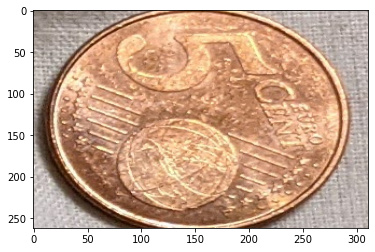

#########################
{'bounding_box': array([0.15057784, 0.43673304, 0.24064755, 0.5154903 ], dtype=float32), 'class_id': 5.0, 'score': 0.91015625}
0.5


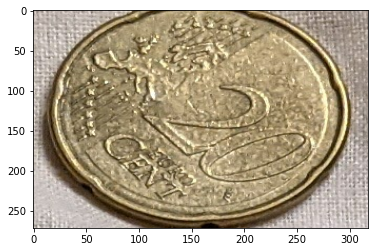

#########################
{'bounding_box': array([0.58322334, 0.44054002, 0.6707263 , 0.51631916], dtype=float32), 'class_id': 5.0, 'score': 0.8828125}
0.5


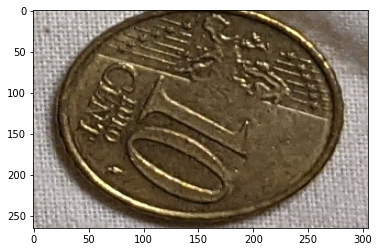

#########################
{'bounding_box': array([0.7712824 , 0.47345924, 0.8685706 , 0.5627278 ], dtype=float32), 'class_id': 5.0, 'score': 0.875}
0.5


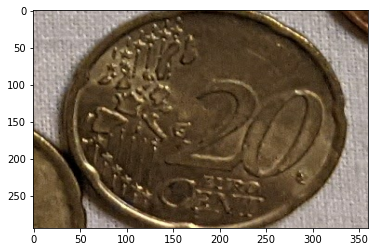

#########################
{'bounding_box': array([0.50383145, 0.52293074, 0.6049431 , 0.61481774], dtype=float32), 'class_id': 5.0, 'score': 0.8671875}
0.5


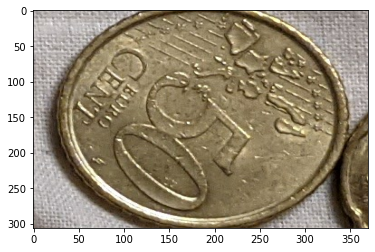

#########################
{'bounding_box': array([0.6979917 , 0.54253006, 0.7934228 , 0.62282   ], dtype=float32), 'class_id': 5.0, 'score': 0.83984375}
0.5


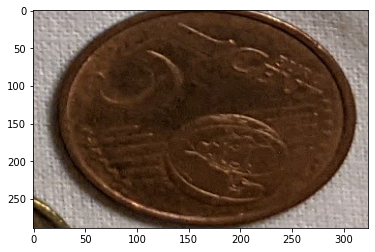

#########################
{'bounding_box': array([0.62223995, 0.19439179, 0.7263174 , 0.2819563 ], dtype=float32), 'class_id': 1.0, 'score': 0.83984375}
0.02


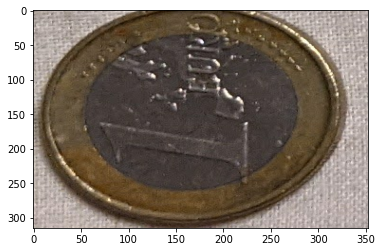

#########################
{'bounding_box': array([0.39230314, 0.38934904, 0.48501477, 0.46963894], dtype=float32), 'class_id': 1.0, 'score': 0.80078125}
0.02


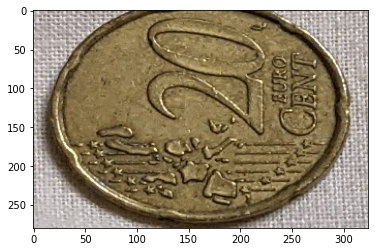

#########################
{'bounding_box': array([0.15412724, 0.5233536 , 0.25426915, 0.61091805], dtype=float32), 'class_id': 7.0, 'score': 0.765625}
2


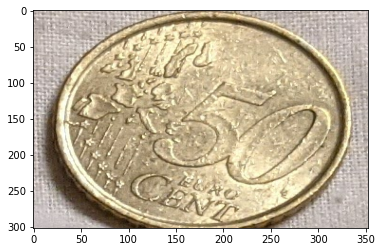

#########################
{'bounding_box': array([0.51667625, 0.31368583, 0.5874625 , 0.37926584], dtype=float32), 'class_id': 5.0, 'score': 0.73828125}
0.5


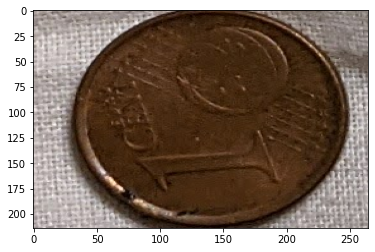

#########################
{'bounding_box': array([0.2982924 , 0.37007093, 0.36978078, 0.43258065], dtype=float32), 'class_id': 5.0, 'score': 0.7265625}
0.5


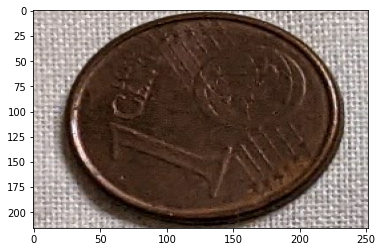

#########################
{'bounding_box': array([0.42835137, 0.80561775, 0.49986485, 0.8681055 ], dtype=float32), 'class_id': 4.0, 'score': 0.69921875}
0.2


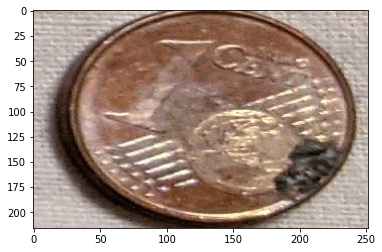

#########################
{'bounding_box': array([0.53657603, 0.601306  , 0.63109195, 0.68719894], dtype=float32), 'class_id': 5.0, 'score': 0.69921875}
0.5


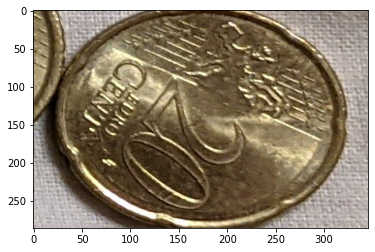

#########################
{'bounding_box': array([0.75574315, 0.2810472 , 0.8530314 , 0.36133716], dtype=float32), 'class_id': 5.0, 'score': 0.6015625}
0.5


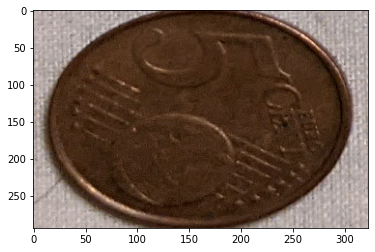

#########################


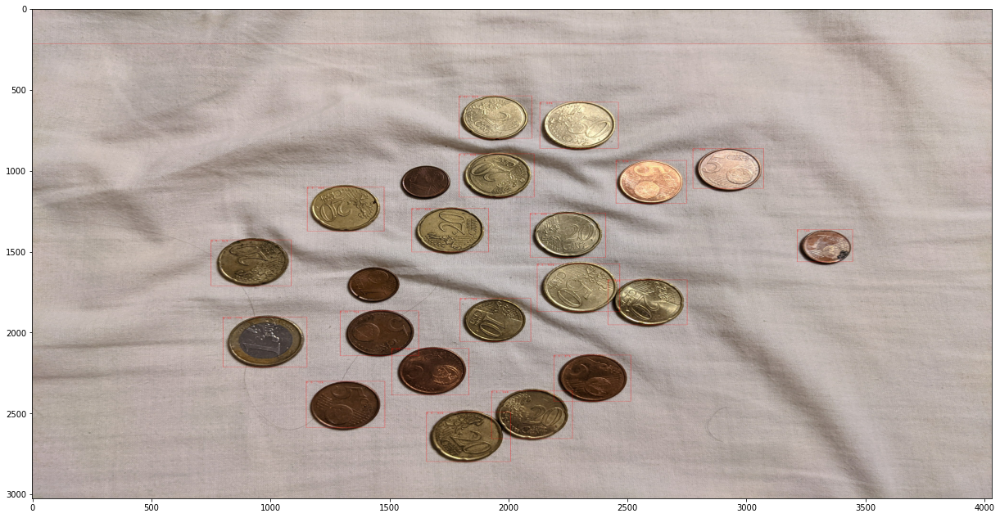

{'bounding_box': array([0.2848238 , 0.6887223 , 0.36661878, 0.76234204], dtype=float32), 'class_id': 6.0, 'score': 0.96484375}
1


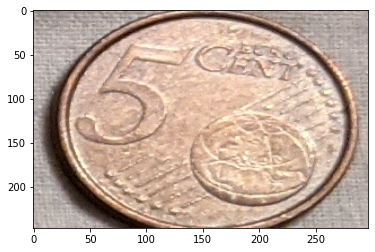

#########################
{'bounding_box': array([0.36370462, 0.28673533, 0.45377433, 0.36702523], dtype=float32), 'class_id': 5.0, 'score': 0.94140625}
0.5


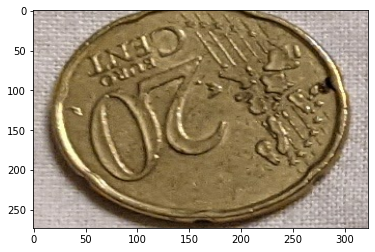

#########################
{'bounding_box': array([0.78055406, 0.47886428, 0.8778423 , 0.5631176 ], dtype=float32), 'class_id': 5.0, 'score': 0.9375}
0.5


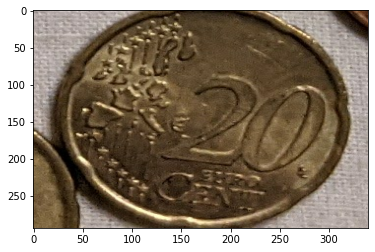

#########################
{'bounding_box': array([0.3093644 , 0.60843277, 0.39689818, 0.6820266 ], dtype=float32), 'class_id': 6.0, 'score': 0.9296875}
1


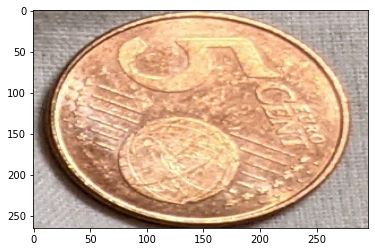

#########################
{'bounding_box': array([0.82362837, 0.41099542, 0.92474   , 0.4985599 ], dtype=float32), 'class_id': 5.0, 'score': 0.91796875}
0.5


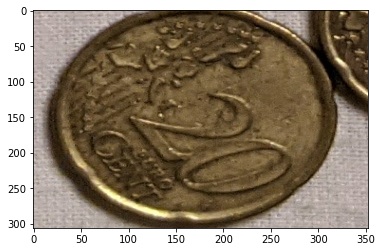

#########################
{'bounding_box': array([0.47186837, 0.18670695, 0.5654777 , 0.2701522 ], dtype=float32), 'class_id': 5.0, 'score': 0.9140625}
0.5


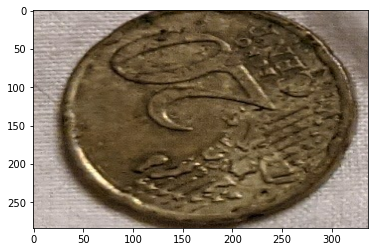

#########################
{'bounding_box': array([0.5208096 , 0.52650726, 0.61809784, 0.6124002 ], dtype=float32), 'class_id': 5.0, 'score': 0.890625}
0.5


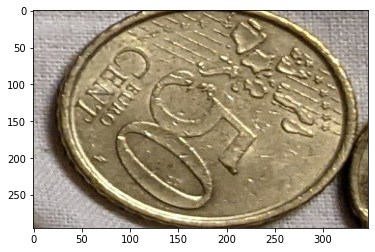

#########################
{'bounding_box': array([0.7070348, 0.543689 , 0.8015506, 0.623979 ], dtype=float32), 'class_id': 5.0, 'score': 0.8671875}
0.5


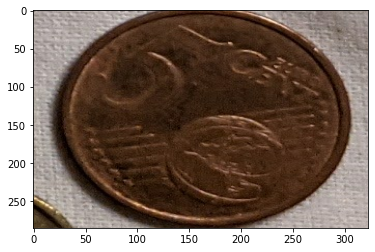

#########################
{'bounding_box': array([0.2959264 , 0.4451167 , 0.38427675, 0.5231186 ], dtype=float32), 'class_id': 5.0, 'score': 0.83984375}
0.5


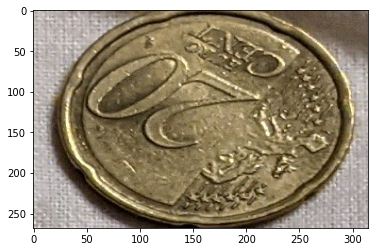

#########################
{'bounding_box': array([0.17756444, 0.44517583, 0.26422828, 0.52095497], dtype=float32), 'class_id': 1.0, 'score': 0.8125}
0.02


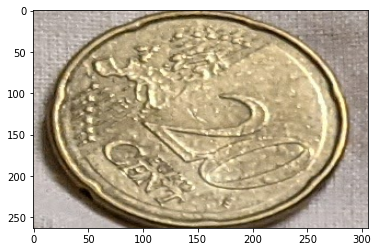

#########################
{'bounding_box': array([0.40727735, 0.3956166 , 0.4964832 , 0.47590655], dtype=float32), 'class_id': 1.0, 'score': 0.8125}
0.02


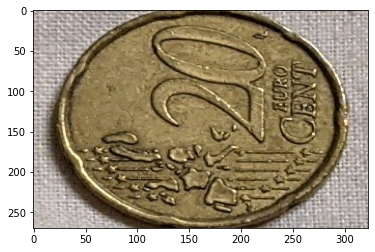

#########################
{'bounding_box': array([0.41727602, 0.519065  , 0.50734574, 0.5978223 ], dtype=float32), 'class_id': 5.0, 'score': 0.80078125}
0.5


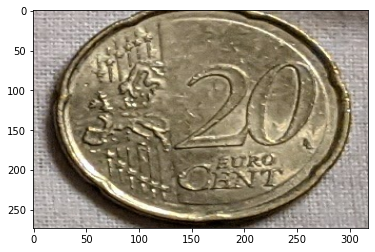

#########################
{'bounding_box': array([0.6933559 , 0.37486207, 0.788787  , 0.45515198], dtype=float32), 'class_id': 1.0, 'score': 0.7890625}
0.02


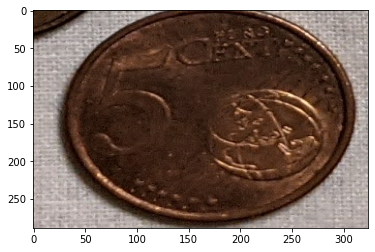

#########################
{'bounding_box': array([0.6295009 , 0.19902761, 0.73159164, 0.2865921 ], dtype=float32), 'class_id': 1.0, 'score': 0.765625}
0.02


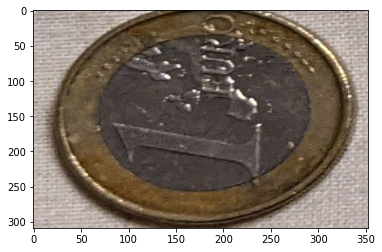

#########################
{'bounding_box': array([0.6167779 , 0.32108885, 0.7086004 , 0.4029413 ], dtype=float32), 'class_id': 1.0, 'score': 0.75390625}
0.02


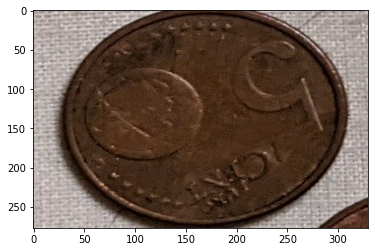

#########################
{'bounding_box': array([0.59091234, 0.44614884, 0.67926264, 0.51976854], dtype=float32), 'class_id': 5.0, 'score': 0.75390625}
0.5


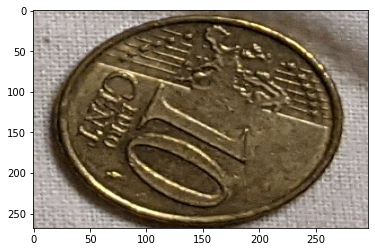

#########################
{'bounding_box': array([0.4509378 , 0.79728186, 0.5164872 , 0.85515356], dtype=float32), 'class_id': 6.0, 'score': 0.73828125}
1


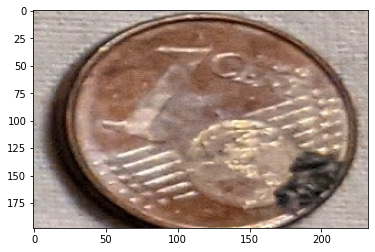

#########################
{'bounding_box': array([0.7606062 , 0.2859541 , 0.85512215, 0.36780646], dtype=float32), 'class_id': 5.0, 'score': 0.69921875}
0.5


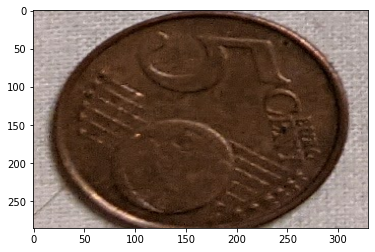

#########################
{'bounding_box': array([0.19033663, 0.52910703, 0.28485247, 0.6109595 ], dtype=float32), 'class_id': 7.0, 'score': 0.68359375}
2


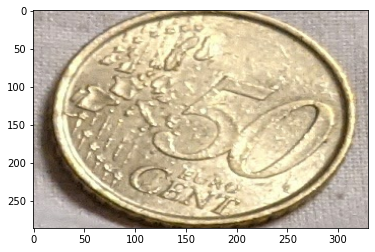

#########################
{'bounding_box': array([0.55346197, 0.60013926, 0.6452845 , 0.6827842 ], dtype=float32), 'class_id': 7.0, 'score': 0.65234375}
2


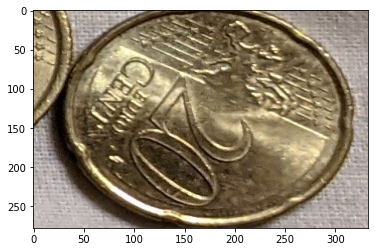

#########################
{'bounding_box': array([ 0.07134736, -0.1551649 ,  1.0163988 ,  1.0349681 ], dtype=float32), 'class_id': 3.0, 'score': 0.65234375}
0.1


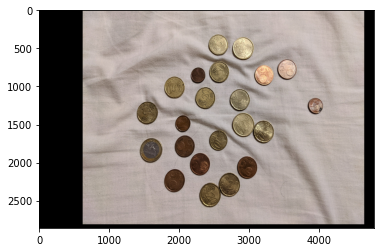

#########################


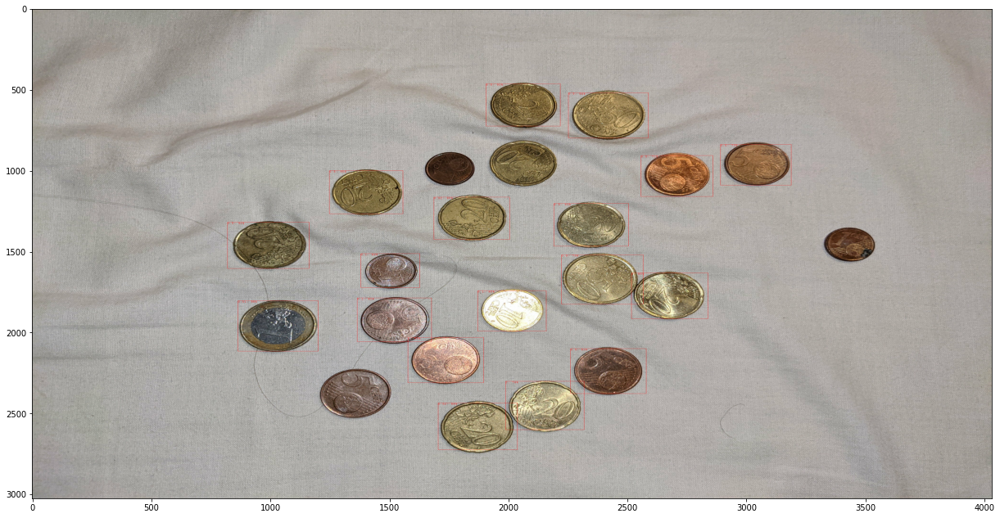

{'bounding_box': array([0.5961305 , 0.21476203, 0.6992459 , 0.29817808], dtype=float32), 'class_id': 0.0, 'score': 0.98046875}
0.01


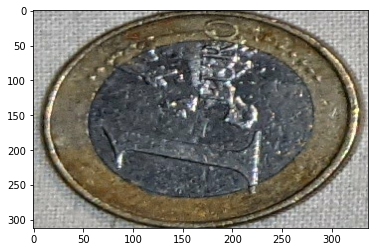

#########################
{'bounding_box': array([0.3300758 , 0.3099712 , 0.41845715, 0.38645732], dtype=float32), 'class_id': 5.0, 'score': 0.9453125}
0.5


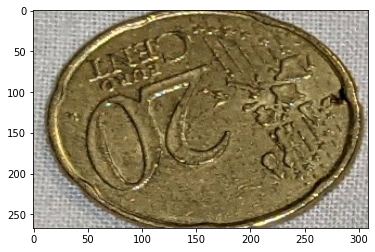

#########################
{'bounding_box': array([0.17106368, 0.5588095 , 0.26377532, 0.6422548 ], dtype=float32), 'class_id': 5.0, 'score': 0.9375}
0.5


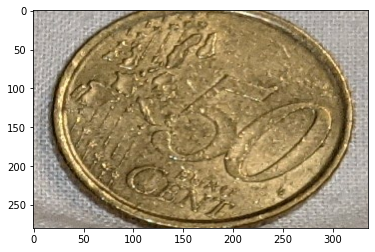

#########################
{'bounding_box': array([0.39722535, 0.54367405, 0.48472837, 0.621676  ], dtype=float32), 'class_id': 5.0, 'score': 0.92578125}
0.5


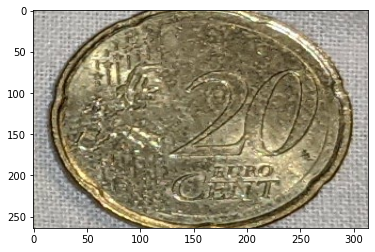

#########################
{'bounding_box': array([0.43570077, 0.20375213, 0.53021663, 0.28882134], dtype=float32), 'class_id': 5.0, 'score': 0.91796875}
0.5


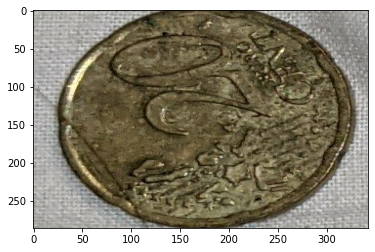

#########################
{'bounding_box': array([0.15275359, 0.473199  , 0.2394174 , 0.5504528 ], dtype=float32), 'class_id': 5.0, 'score': 0.91796875}
0.5


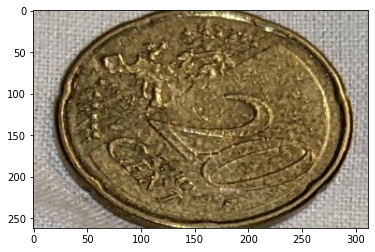

#########################
{'bounding_box': array([0.67106366, 0.3917471 , 0.76377535, 0.47050437], dtype=float32), 'class_id': 6.0, 'score': 0.890625}
1


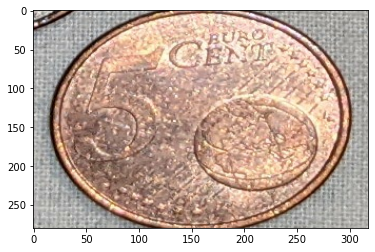

#########################
{'bounding_box': array([0.80513453, 0.4233063 , 0.9005656 , 0.5059513 ], dtype=float32), 'class_id': 1.0, 'score': 0.875}
0.02


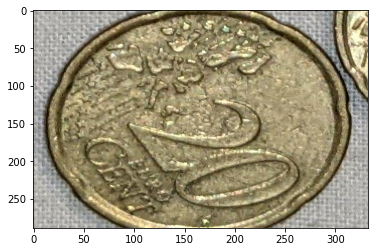

#########################
{'bounding_box': array([0.5393472 , 0.62466764, 0.6329566 , 0.7041875 ], dtype=float32), 'class_id': 7.0, 'score': 0.8515625}
2


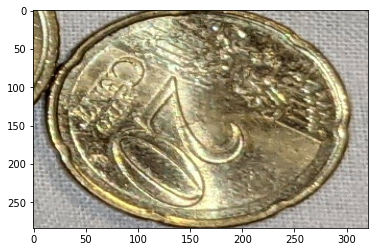

#########################
{'bounding_box': array([0.69400126, 0.56115353, 0.78582376, 0.6399108 ], dtype=float32), 'class_id': 5.0, 'score': 0.83203125}
0.5


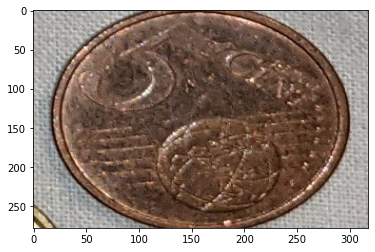

#########################
{'bounding_box': array([0.59048456, 0.33892736, 0.6796904 , 0.41618124], dtype=float32), 'class_id': 3.0, 'score': 0.8203125}
0.1


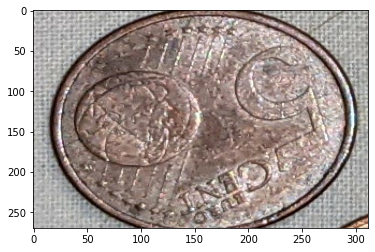

#########################
{'bounding_box': array([0.38442364, 0.4188759 , 0.4710875 , 0.49763313], dtype=float32), 'class_id': 1.0, 'score': 0.80078125}
0.02


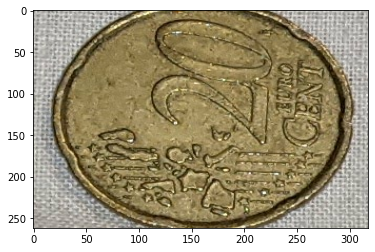

#########################
{'bounding_box': array([0.575583  , 0.4643376 , 0.65819895, 0.5358343 ], dtype=float32), 'class_id': 3.0, 'score': 0.80078125}
0.1


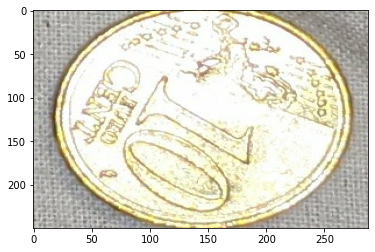

#########################
{'bounding_box': array([0.49985325, 0.34257886, 0.5693288 , 0.40387377], dtype=float32), 'class_id': 3.0, 'score': 0.80078125}
0.1


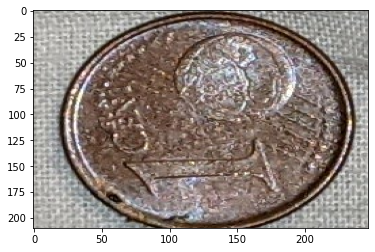

#########################
{'bounding_box': array([0.7605913 , 0.49339277, 0.85977286, 0.5752452 ], dtype=float32), 'class_id': 7.0, 'score': 0.73828125}
2


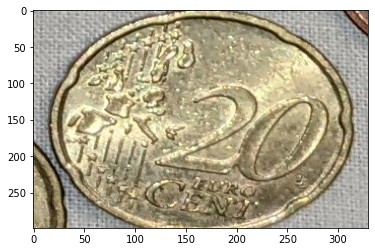

#########################
{'bounding_box': array([0.50219977, 0.55162334, 0.6033114 , 0.6366925 ], dtype=float32), 'class_id': 5.0, 'score': 0.7265625}
0.5


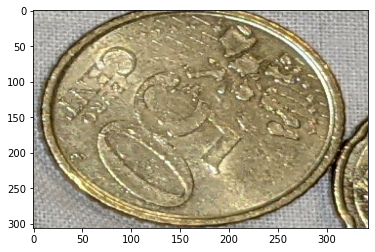

#########################
{'bounding_box': array([0.27660143, 0.71748286, 0.35998815, 0.7911026 ], dtype=float32), 'class_id': 5.0, 'score': 0.7265625}
0.5


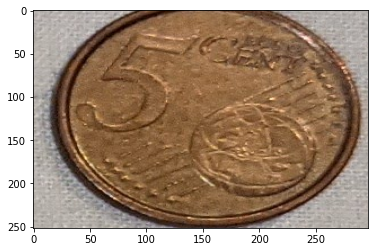

#########################
{'bounding_box': array([0.29956716, 0.6344346 , 0.38295388, 0.70948696], dtype=float32), 'class_id': 5.0, 'score': 0.7109375}
0.5


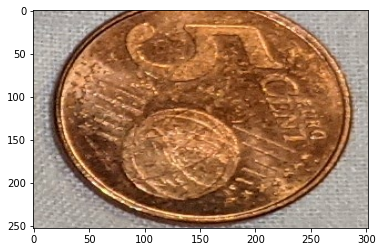

#########################


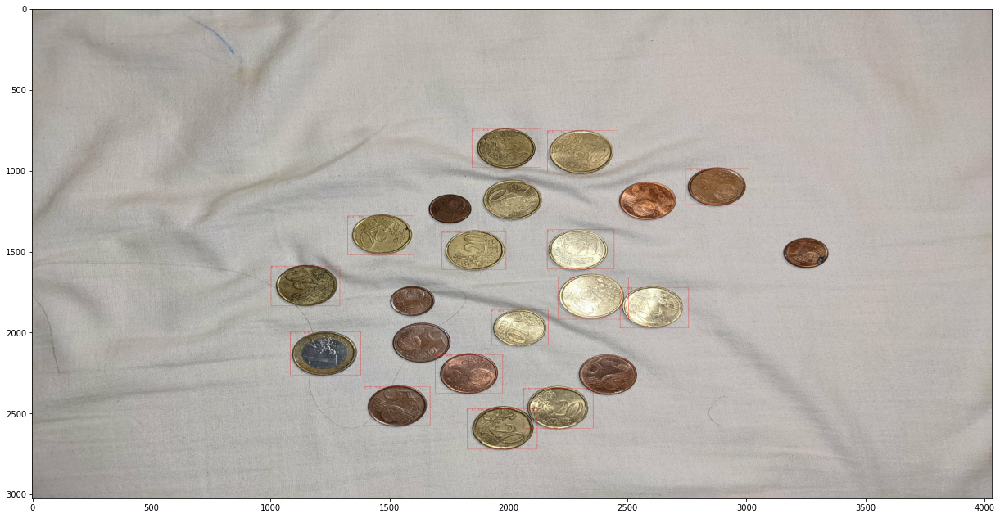

{'bounding_box': array([0.6595275 , 0.269147  , 0.7479088 , 0.34274086], dtype=float32), 'class_id': 0.0, 'score': 0.9140625}
0.01


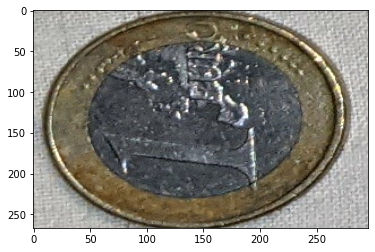

#########################
{'bounding_box': array([0.42275673, 0.32906502, 0.5022673 , 0.3978743 ], dtype=float32), 'class_id': 5.0, 'score': 0.89453125}
0.5


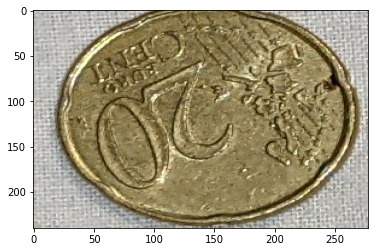

#########################
{'bounding_box': array([0.32601368, 0.6810044 , 0.39962476, 0.7472117 ], dtype=float32), 'class_id': 5.0, 'score': 0.89453125}
0.5


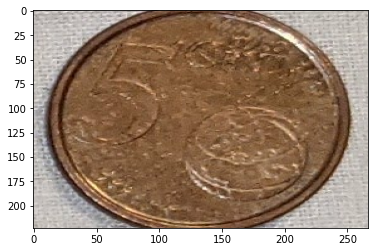

#########################
{'bounding_box': array([0.8166653 , 0.45345563, 0.8992523 , 0.5263693 ], dtype=float32), 'class_id': 5.0, 'score': 0.8515625}
0.5


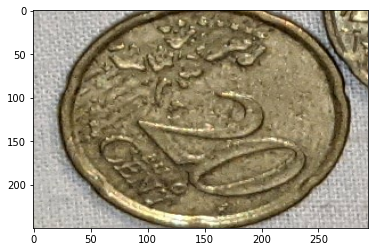

#########################
{'bounding_box': array([0.56902695, 0.6127594 , 0.6516429 , 0.684256  ], dtype=float32), 'class_id': 7.0, 'score': 0.8515625}
2


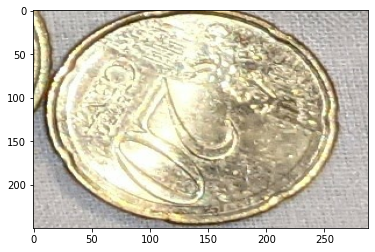

#########################
{'bounding_box': array([0.245217  , 0.4585669 , 0.32396504, 0.5300804 ], dtype=float32), 'class_id': 5.0, 'score': 0.83203125}
0.5


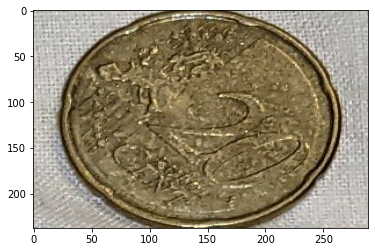

#########################
{'bounding_box': array([0.77507937, 0.512592  , 0.85687435, 0.5848064 ], dtype=float32), 'class_id': 5.0, 'score': 0.8125}
0.5


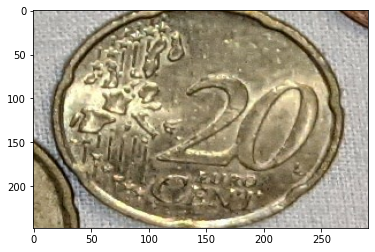

#########################
{'bounding_box': array([0.7063106 , 0.42027068, 0.785031  , 0.4904436 ], dtype=float32), 'class_id': 5.0, 'score': 0.80078125}
0.5


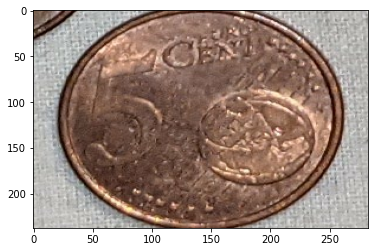

#########################
{'bounding_box': array([0.24841748, 0.5370041 , 0.33595124, 0.61059797], dtype=float32), 'class_id': 5.0, 'score': 0.7890625}
0.5


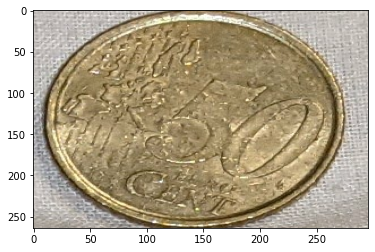

#########################
{'bounding_box': array([0.771609  , 0.34604305, 0.8510731 , 0.41486037], dtype=float32), 'class_id': 5.0, 'score': 0.7265625}
0.5


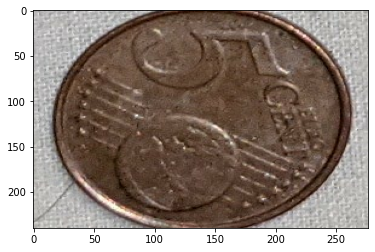

#########################
{'bounding_box': array([0.52525854, 0.24923244, 0.6062975 , 0.32072917], dtype=float32), 'class_id': 5.0, 'score': 0.7109375}
0.5


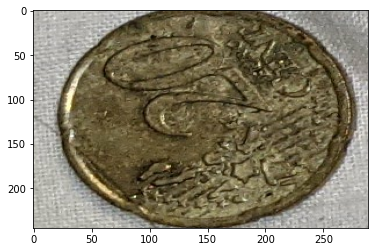

#########################
{'bounding_box': array([0.5478714 , 0.5485361 , 0.6337041 , 0.62144977], dtype=float32), 'class_id': 3.0, 'score': 0.68359375}
0.1


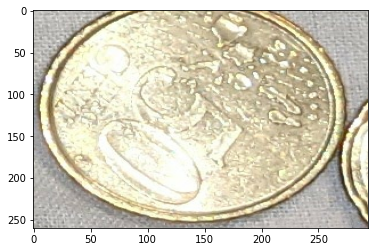

#########################
{'bounding_box': array([0.4509452 , 0.5369487 , 0.5311976 , 0.60644865], dtype=float32), 'class_id': 3.0, 'score': 0.66796875}
0.1


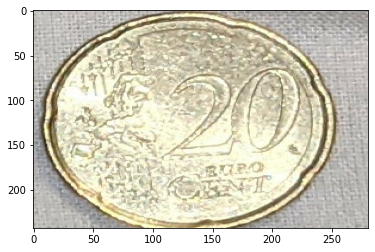

#########################
{'bounding_box': array([0.45364875, 0.42713645, 0.5323968 , 0.4939849 ], dtype=float32), 'class_id': 1.0, 'score': 0.62109375}
0.02


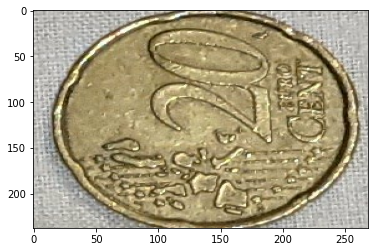

#########################
{'bounding_box': array([0.6150323 , 0.4787895 , 0.6872382 , 0.53776664], dtype=float32), 'class_id': 7.0, 'score': 0.6015625}
2


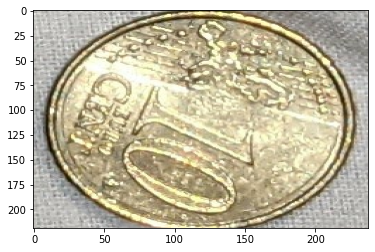

#########################


In [18]:
DETECTION_THRESHOLD = 0.6

# Load the TFLite model
interpreter = tf.lite.Interpreter(model_path='detector_multiple_class.tflite')
interpreter.allocate_tensors()

test_folder = "../data/test/"
test_files_raw = next(walk(test_folder), (None, None, []))[2]
test_files = [test_folder+x for x in test_files_raw]

for test_file in test_files:
    # Run inference and draw detection result on the local copy of the original file
    detection_result_image, results, detected_coins = run_odt_and_draw_results(
        test_file,
        interpreter,
        threshold=DETECTION_THRESHOLD,
        draw=True
    )
    # Show the detection result
    plt.figure(figsize = (21,11))
    plt.imshow(np.asarray(detection_result_image), aspect="auto")
    detection_result_image
    plt.show()
    
    for res, img in zip(results, detected_coins):
        print(res)
        print(classes[int(res["class_id"])])
        plt.imshow(np.asarray(img), aspect="auto")
        plt.show()
        print("#"*25)


# Train using just coin as a label

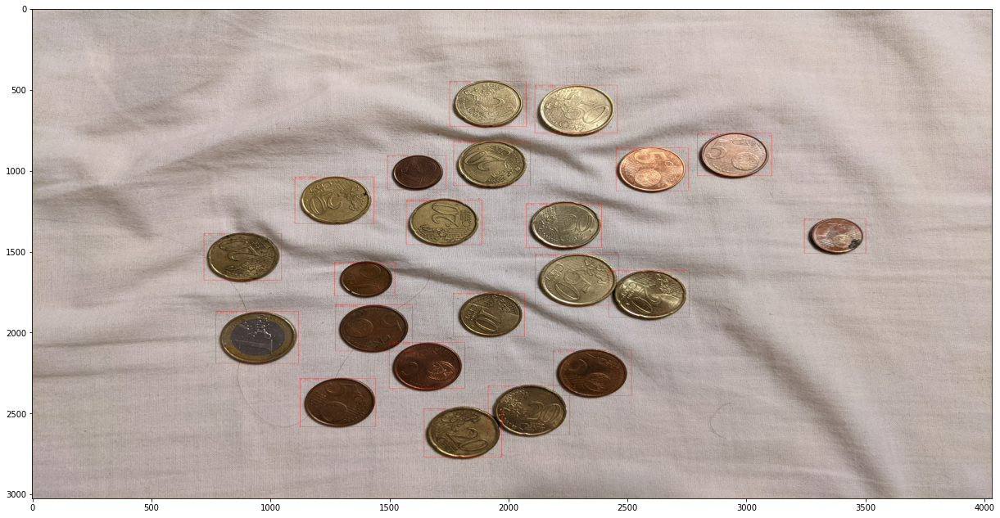

{'bounding_box': array([0.58058715, 0.43884787, 0.66929793, 0.5129723 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


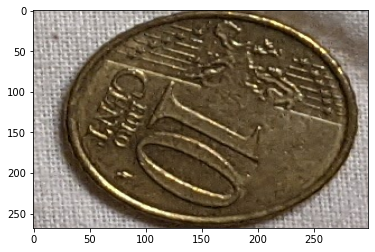

#########################
{'bounding_box': array([0.28377217, 0.60854036, 0.3715505 , 0.6842479 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


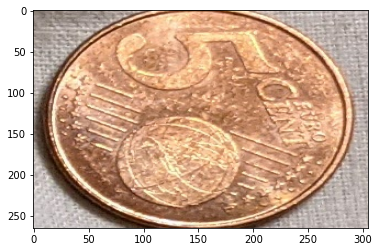

#########################
{'bounding_box': array([0.2694118 , 0.43948203, 0.3609798 , 0.5192972 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


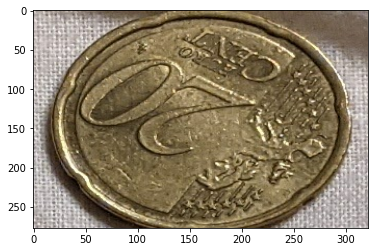

#########################
{'bounding_box': array([0.4584721 , 0.17928839, 0.5539934 , 0.25995138], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


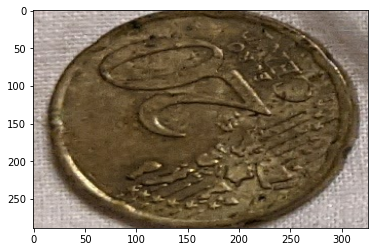

#########################
{'bounding_box': array([0.681844  , 0.3720674 , 0.77536774, 0.45104355], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


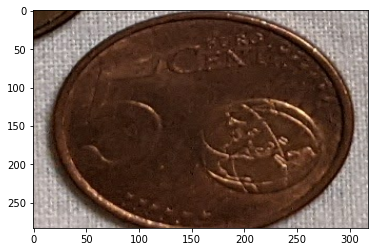

#########################
{'bounding_box': array([0.6045271 , 0.31627923, 0.69904435, 0.39609438], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


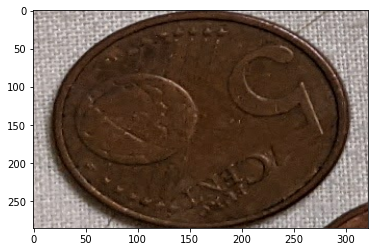

#########################
{'bounding_box': array([0.76933694, 0.47528008, 0.87004066, 0.5603194 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


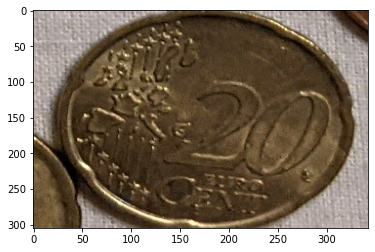

#########################
{'bounding_box': array([0.147405  , 0.4351039 , 0.23994571, 0.51491904], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


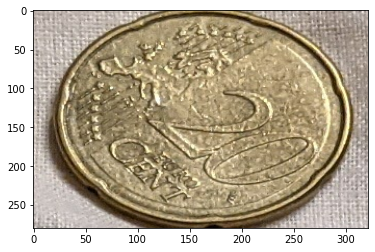

#########################
{'bounding_box': array([0.29871833, 0.37038624, 0.3691281 , 0.43175876], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


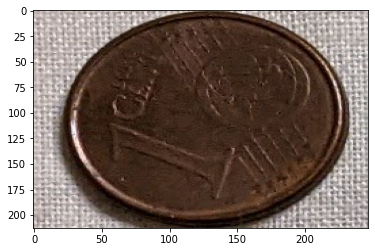

#########################
{'bounding_box': array([0.6970054 , 0.54319155, 0.79052913, 0.6247114 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


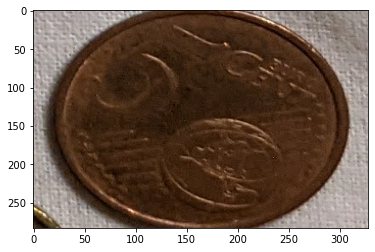

#########################
{'bounding_box': array([0.5169401 , 0.31544614, 0.58660984, 0.37812954], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


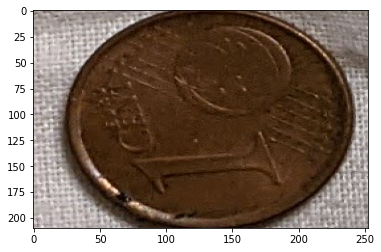

#########################
{'bounding_box': array([0.816355  , 0.4085855 , 0.91578794, 0.48942065], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


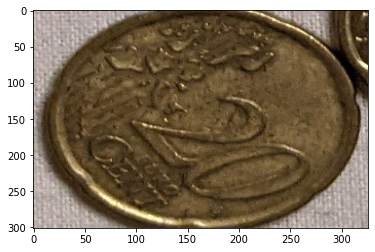

#########################
{'bounding_box': array([0.397377  , 0.5150833 , 0.48778945, 0.5933962 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


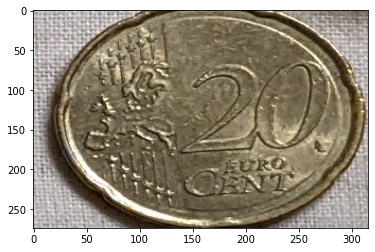

#########################
{'bounding_box': array([0.34324187, 0.2740029 , 0.4387632 , 0.3563887 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


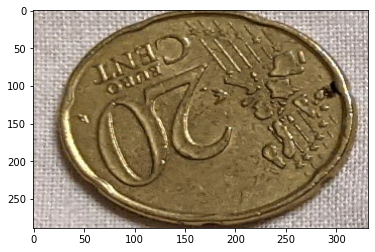

#########################
{'bounding_box': array([0.5343936 , 0.600727  , 0.62991494, 0.68487245], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


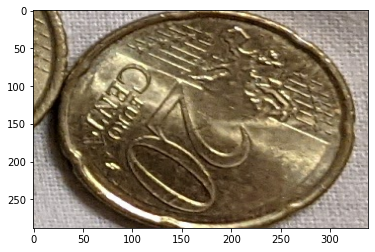

#########################
{'bounding_box': array([0.25391084, 0.69342315, 0.3407665 , 0.7707478 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


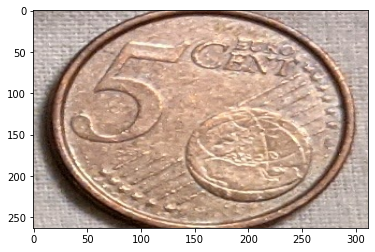

#########################
{'bounding_box': array([0.15567778, 0.5240217 , 0.25323927, 0.6099643 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


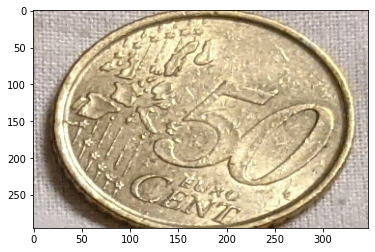

#########################
{'bounding_box': array([0.3899188 , 0.38992453, 0.4814868 , 0.46890068], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


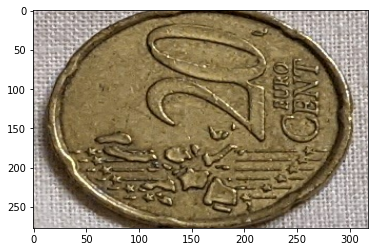

#########################
{'bounding_box': array([0.61794305, 0.19165428, 0.72388434, 0.27778047], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


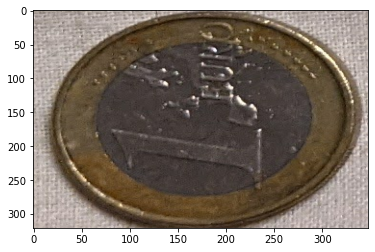

#########################
{'bounding_box': array([0.50154036, 0.5244638 , 0.60548764, 0.6113194 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


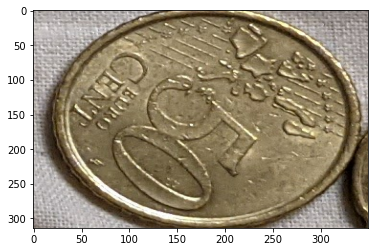

#########################
{'bounding_box': array([0.7551137 , 0.27930212, 0.8537115 , 0.35827827], dtype=float32), 'class_id': 0.0, 'score': 0.9921875}
0.01


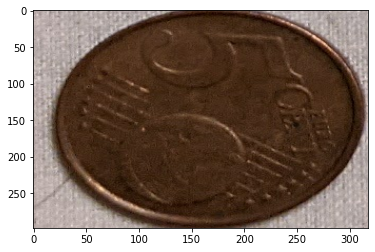

#########################
{'bounding_box': array([0.4283369 , 0.804765  , 0.49949464, 0.8687873 ], dtype=float32), 'class_id': 0.0, 'score': 0.984375}
0.01


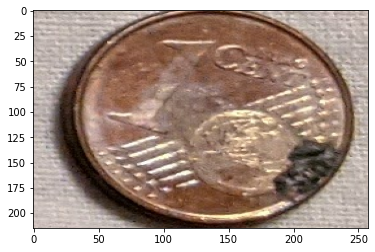

#########################


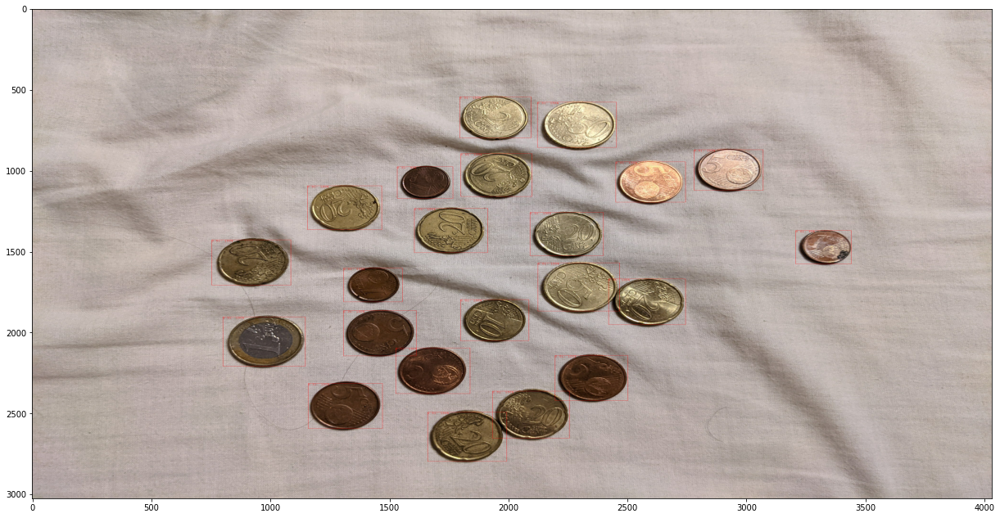

{'bounding_box': array([0.6925124 , 0.37918335, 0.78603613, 0.45650798], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


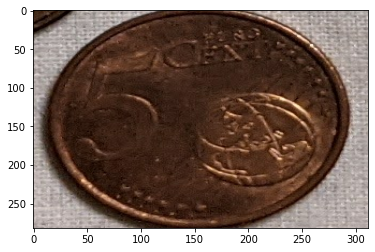

#########################
{'bounding_box': array([0.19030808, 0.5266987 , 0.2828488 , 0.6090845 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


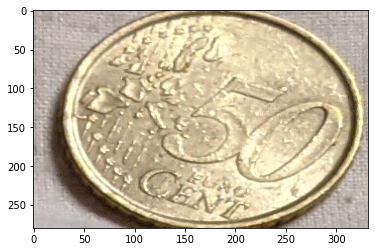

#########################
{'bounding_box': array([0.3613373 , 0.28720182, 0.45099044, 0.36452645], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


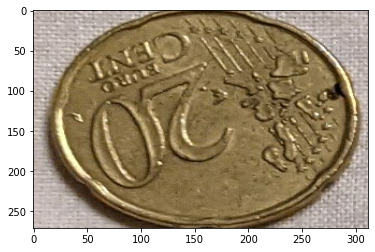

#########################
{'bounding_box': array([0.4073586 , 0.3983455 , 0.49796408, 0.4748573 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


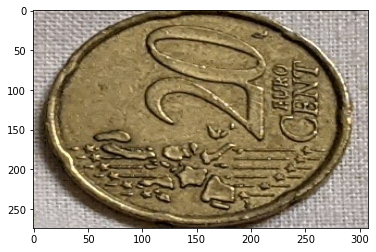

#########################
{'bounding_box': array([0.551552  , 0.60092527, 0.64487654, 0.68091077], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


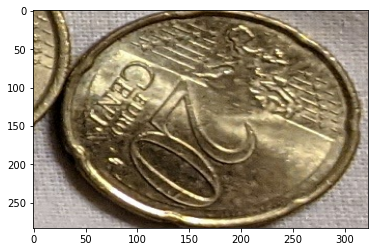

#########################
{'bounding_box': array([0.2953391 , 0.4468204 , 0.38311744, 0.52094483], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


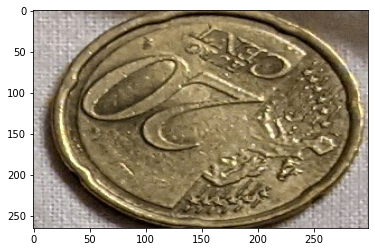

#########################
{'bounding_box': array([0.61618376, 0.3246232 , 0.7087244 , 0.4003308 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


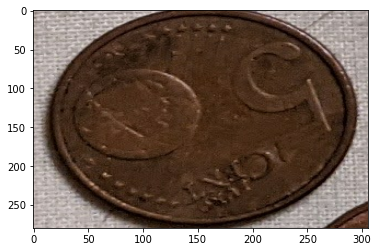

#########################
{'bounding_box': array([0.28754452, 0.68977344, 0.37062815, 0.7617383 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


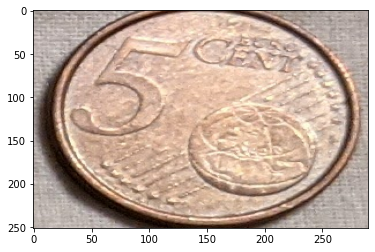

#########################
{'bounding_box': array([0.7076735 , 0.54496413, 0.80001706, 0.62083334], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


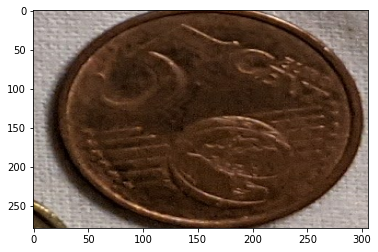

#########################
{'bounding_box': array([0.17934434, 0.4459218 , 0.2634898 , 0.52004623], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


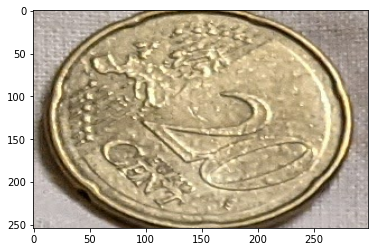

#########################
{'bounding_box': array([0.7650574 , 0.28779987, 0.85740095, 0.36528954], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


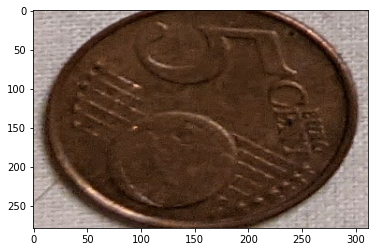

#########################
{'bounding_box': array([0.51859266, 0.5271691 , 0.61719054, 0.6122085 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


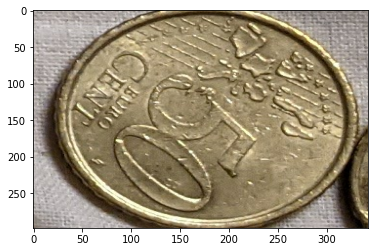

#########################
{'bounding_box': array([0.593653  , 0.44667193, 0.67779845, 0.51772857], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


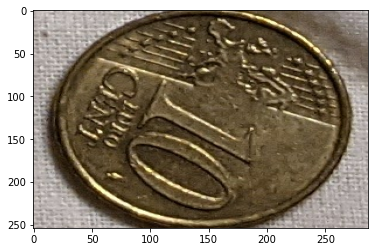

#########################
{'bounding_box': array([0.41537988, 0.5188525 , 0.50409067, 0.59536433], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


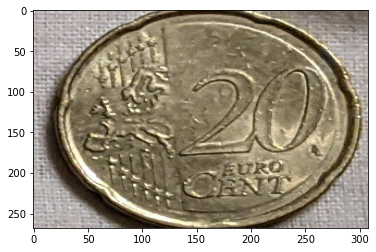

#########################
{'bounding_box': array([0.7809211, 0.4798035, 0.8772515, 0.559789 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


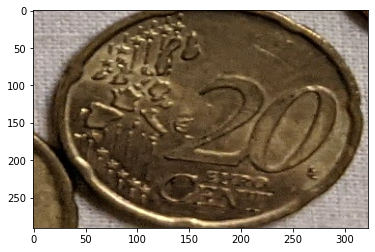

#########################
{'bounding_box': array([0.31241295, 0.6083098 , 0.3947988 , 0.68088406], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


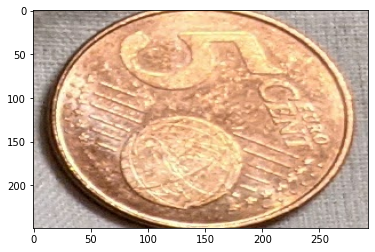

#########################
{'bounding_box': array([0.82380694, 0.41236702, 0.9245108 , 0.49475285], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


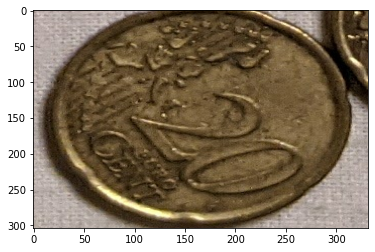

#########################
{'bounding_box': array([0.4716442 , 0.18741296, 0.5641849 , 0.2697988 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


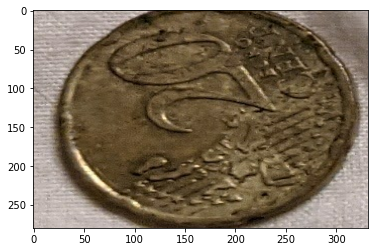

#########################
{'bounding_box': array([0.6291756 , 0.19899869, 0.7298793 , 0.28494138], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


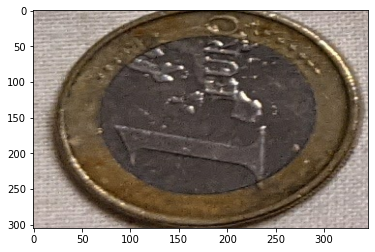

#########################
{'bounding_box': array([0.5294578 , 0.32466018, 0.5983951 , 0.3860327 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


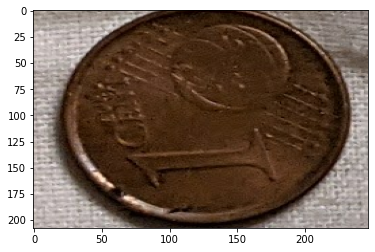

#########################
{'bounding_box': array([0.45268574, 0.7958503 , 0.5208985 , 0.85345256], dtype=float32), 'class_id': 0.0, 'score': 0.9921875}
0.01


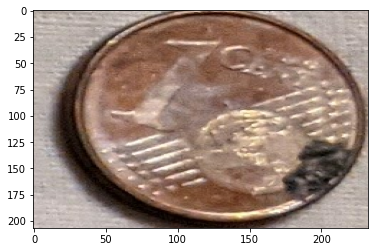

#########################
{'bounding_box': array([0.32228208, 0.38052407, 0.3869844 , 0.4387382 ], dtype=float32), 'class_id': 0.0, 'score': 0.98828125}
0.01


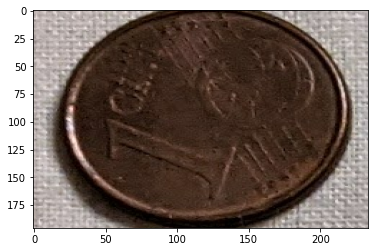

#########################


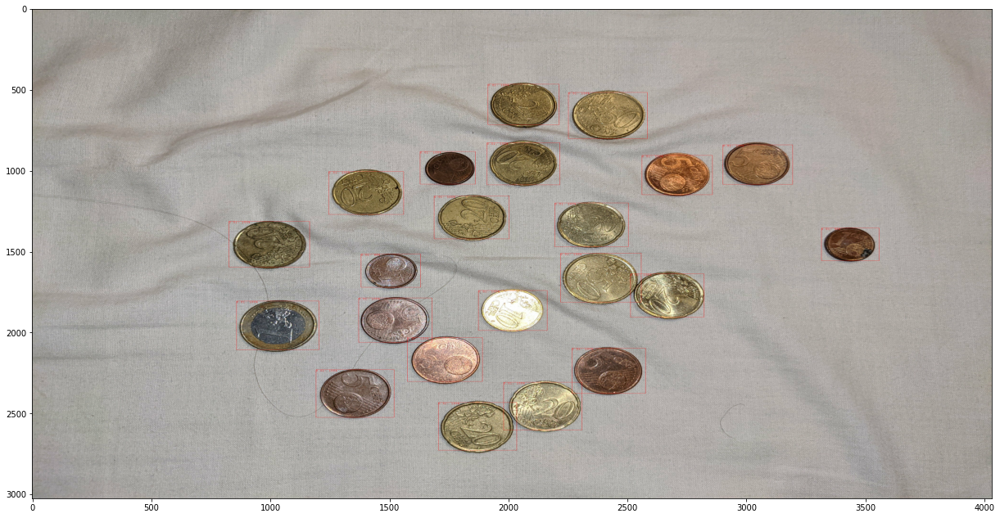

{'bounding_box': array([0.15358305, 0.47496426, 0.23666668, 0.5492469 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


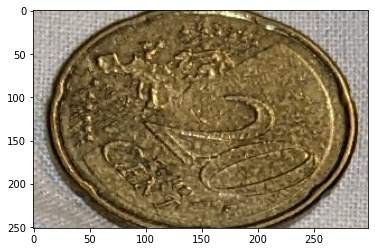

#########################
{'bounding_box': array([0.5966863 , 0.21326141, 0.69633156, 0.29920414], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


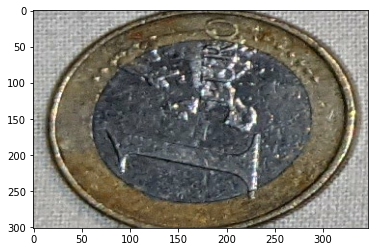

#########################
{'bounding_box': array([0.2775601 , 0.7199456 , 0.35822308, 0.79251987], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


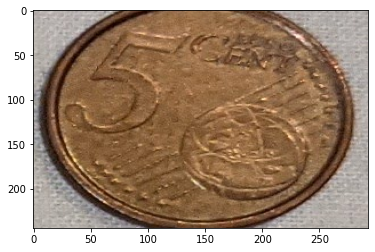

#########################
{'bounding_box': array([0.29125825, 0.40441954, 0.35804453, 0.46202183], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


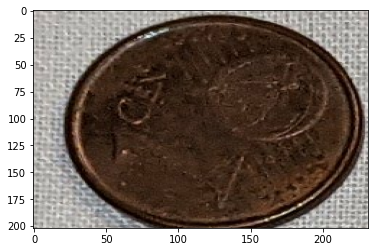

#########################
{'bounding_box': array([0.49931318, 0.55074996, 0.59895843, 0.6348954 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


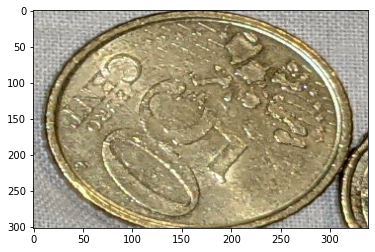

#########################
{'bounding_box': array([0.3820439 , 0.4189799 , 0.46982223, 0.49712595], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


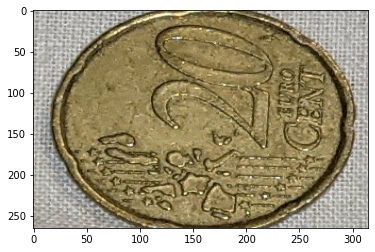

#########################
{'bounding_box': array([0.5411795, 0.6236804, 0.6297013, 0.7003556], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


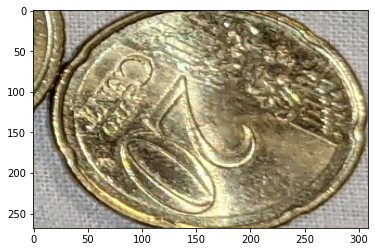

#########################
{'bounding_box': array([0.7628207 , 0.4914174 , 0.8603821 , 0.57293725], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


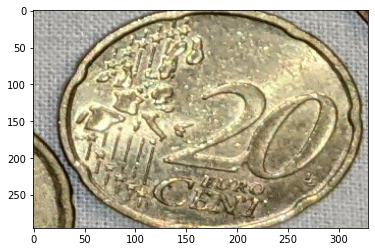

#########################
{'bounding_box': array([0.8039266 , 0.4235832 , 0.90148795, 0.50510305], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


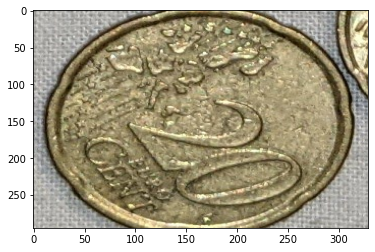

#########################
{'bounding_box': array([0.6930039 , 0.5626542 , 0.78554463, 0.63916594], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


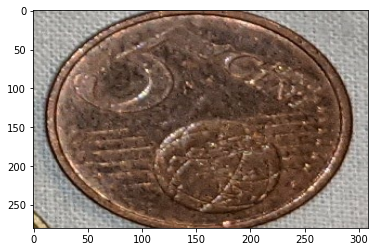

#########################
{'bounding_box': array([0.6713138 , 0.3912382 , 0.76096684, 0.4693842 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


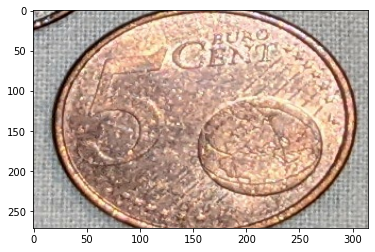

#########################
{'bounding_box': array([0.73687613, 0.2958874 , 0.8344376 , 0.37740725], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


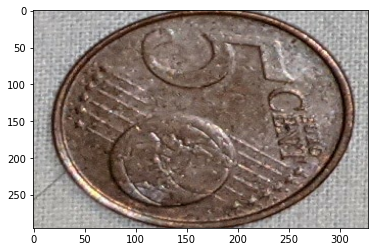

#########################
{'bounding_box': array([0.17056406, 0.5588186 , 0.26508132, 0.64120436], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


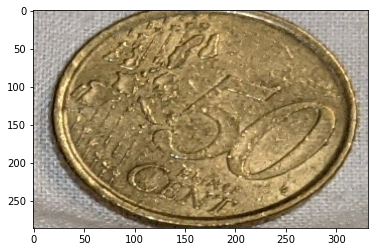

#########################
{'bounding_box': array([0.33206683, 0.30914125, 0.41984516, 0.3872873 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


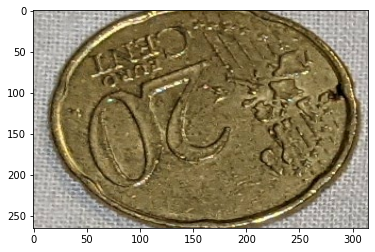

#########################
{'bounding_box': array([0.29900724, 0.63543355, 0.37949836, 0.7089354 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


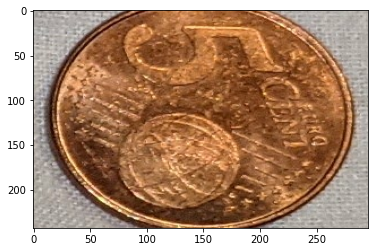

#########################
{'bounding_box': array([0.39626783, 0.54479694, 0.48592097, 0.6213088 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


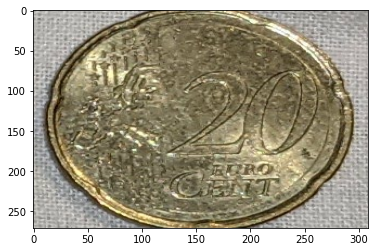

#########################
{'bounding_box': array([0.27343264, 0.47417098, 0.35919222, 0.5500402 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


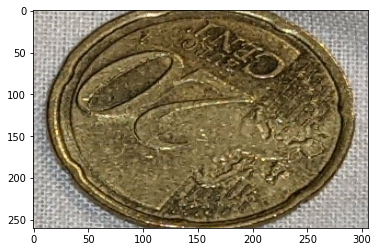

#########################
{'bounding_box': array([0.43364117, 0.2052889 , 0.52716494, 0.28943437], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


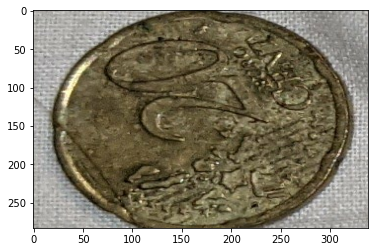

#########################
{'bounding_box': array([0.57531154, 0.46505025, 0.6568314 , 0.5368617 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


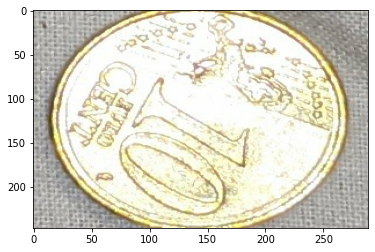

#########################
{'bounding_box': array([0.590423  , 0.34028107, 0.6810285 , 0.41679293], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


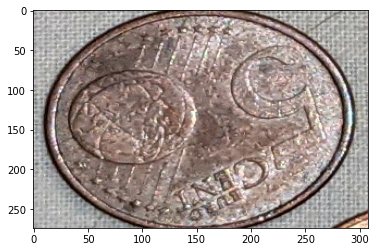

#########################
{'bounding_box': array([0.44766656, 0.822449  , 0.5144529 , 0.88253814], dtype=float32), 'class_id': 0.0, 'score': 0.98046875}
0.01


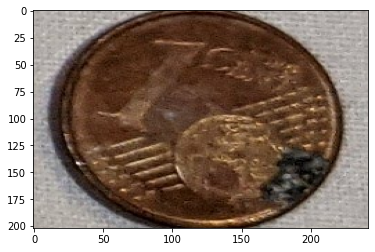

#########################
{'bounding_box': array([0.50052476, 0.34290457, 0.5687375 , 0.4049291 ], dtype=float32), 'class_id': 0.0, 'score': 0.98046875}
0.01


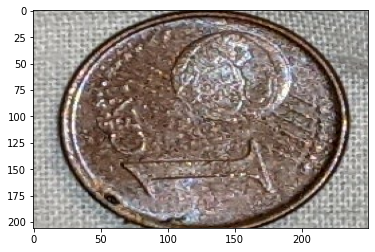

#########################


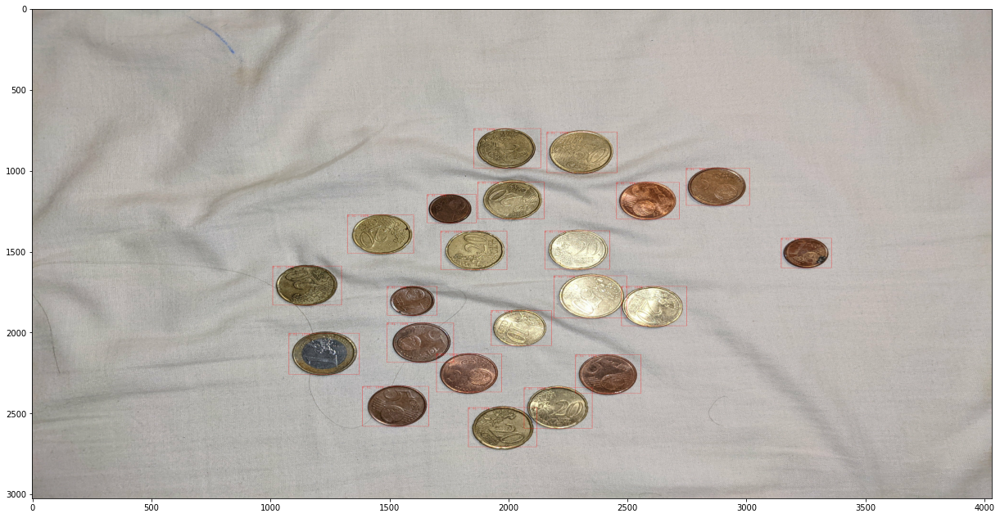

{'bounding_box': array([0.25121516, 0.5364957 , 0.33447617, 0.60984087], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


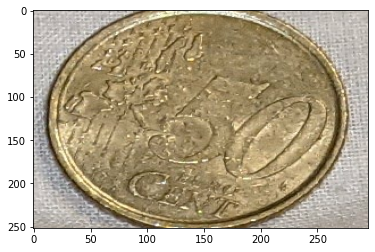

#########################
{'bounding_box': array([0.566754  , 0.6141334 , 0.64741695, 0.68224925], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


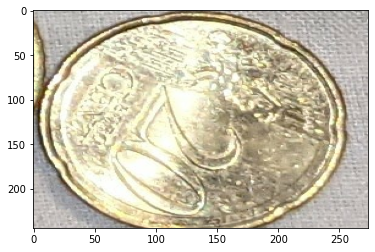

#########################
{'bounding_box': array([0.5451968, 0.543876 , 0.6312617, 0.6196913], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


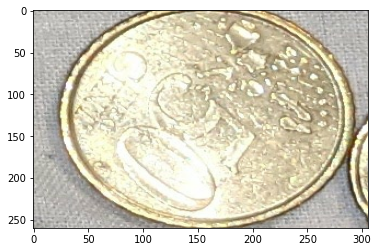

#########################
{'bounding_box': array([0.45336926, 0.53445786, 0.53162646, 0.60195357], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


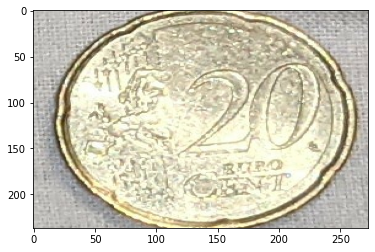

#########################
{'bounding_box': array([0.64140546, 0.36980376, 0.7221831 , 0.43947342], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


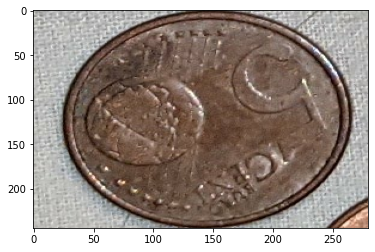

#########################
{'bounding_box': array([0.7709689 , 0.34446737, 0.8526046 , 0.41340473], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


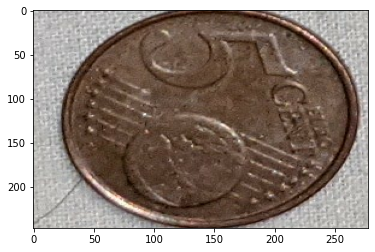

#########################
{'bounding_box': array([0.6159055 , 0.47852856, 0.68766594, 0.5413458 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


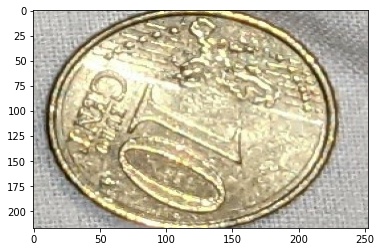

#########################
{'bounding_box': array([0.6623858 , 0.2678548 , 0.74653125, 0.3412001 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


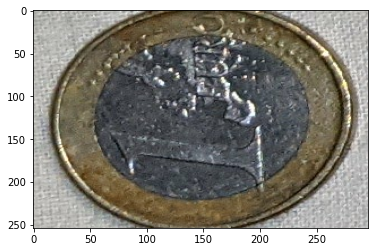

#########################
{'bounding_box': array([0.81432277, 0.4548318 , 0.89481384, 0.52604014], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


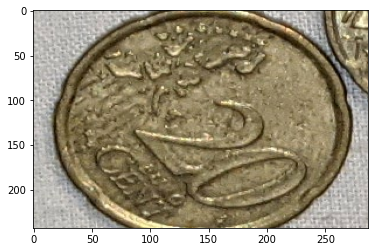

#########################
{'bounding_box': array([0.77356535, 0.5127089 , 0.85682625, 0.5837655 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


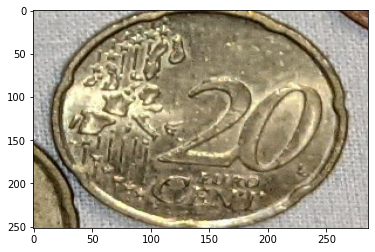

#########################
{'bounding_box': array([0.3532636 , 0.46437344, 0.4289712 , 0.53394413], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


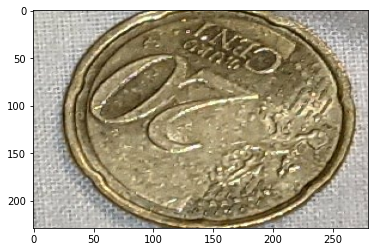

#########################
{'bounding_box': array([0.7046233 , 0.42158526, 0.78260285, 0.489129  ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


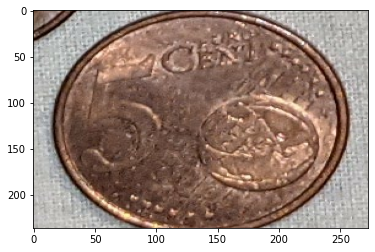

#########################
{'bounding_box': array([0.42053455, 0.32874987, 0.49879175, 0.39768723], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


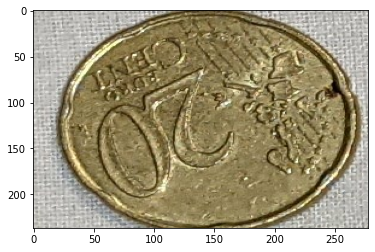

#########################
{'bounding_box': array([0.45366684, 0.42588097, 0.5327554 , 0.49481833], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


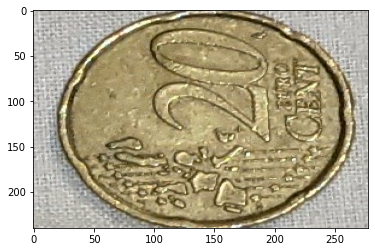

#########################
{'bounding_box': array([0.5252882 , 0.25076458, 0.6051034 , 0.32257608], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


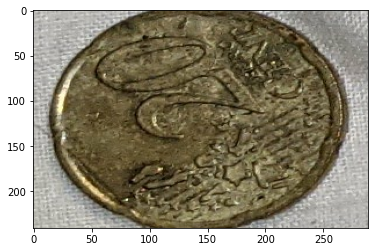

#########################
{'bounding_box': array([0.24424225, 0.46051592, 0.32501996, 0.5301856 ], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


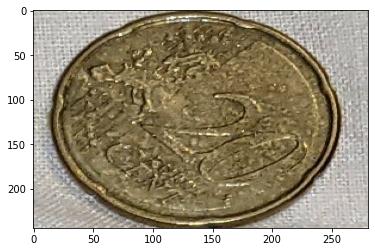

#########################
{'bounding_box': array([0.7065197, 0.5662475, 0.7856083, 0.6344603], dtype=float32), 'class_id': 0.0, 'score': 0.99609375}
0.01


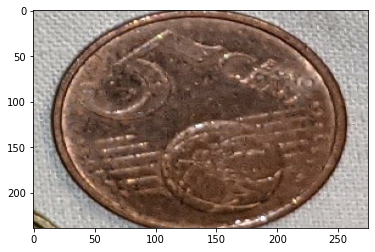

#########################
{'bounding_box': array([0.3253109, 0.6815869, 0.4011262, 0.7476712], dtype=float32), 'class_id': 0.0, 'score': 0.9921875}
0.01


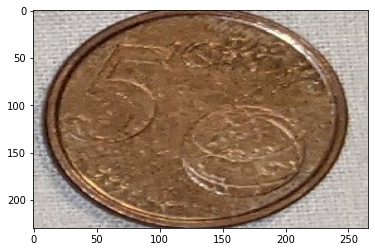

#########################
{'bounding_box': array([0.5670579 , 0.37017497, 0.6259741 , 0.42207482], dtype=float32), 'class_id': 0.0, 'score': 0.9921875}
0.01


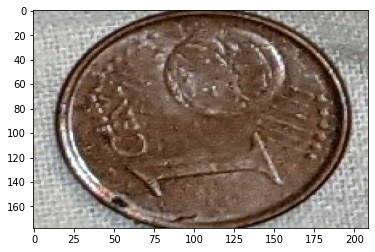

#########################
{'bounding_box': array([0.35426477, 0.6090791 , 0.42928317, 0.67446876], dtype=float32), 'class_id': 0.0, 'score': 0.98828125}
0.01


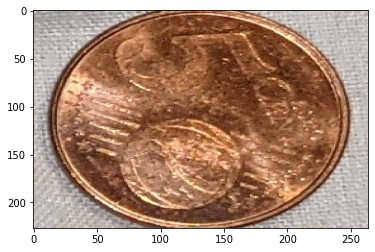

#########################
{'bounding_box': array([0.3788641 , 0.41182286, 0.43716115, 0.46317714], dtype=float32), 'class_id': 0.0, 'score': 0.98046875}
0.01


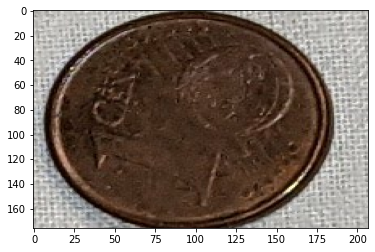

#########################
{'bounding_box': array([0.4680235 , 0.7806136 , 0.5288374 , 0.83306473], dtype=float32), 'class_id': 0.0, 'score': 0.97265625}
0.01


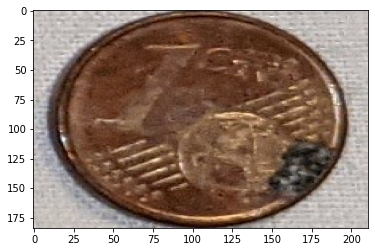

#########################


In [15]:
DETECTION_THRESHOLD = 0.6

# Load the TFLite model
interpreter = tf.lite.Interpreter(model_path="detector_one_class.tflite")
interpreter.allocate_tensors()

test_folder = "../data/test/"
test_files_raw = next(walk(test_folder), (None, None, []))[2]
test_files = [test_folder+x for x in test_files_raw]

for test_file in test_files:
    # Run inference and draw detection result on the local copy of the original file
    detection_result_image, results, detected_coins = run_odt_and_draw_results(
        test_file,
        interpreter,
        threshold=DETECTION_THRESHOLD,
        draw=True
    )
    # Show the detection result
    plt.figure(figsize = (21,11))
    plt.imshow(np.asarray(detection_result_image), aspect="auto")
    detection_result_image
    plt.show()
    
    for res, img in zip(results, detected_coins):
        print(res)
        print(classes[int(res["class_id"])])
        plt.imshow(np.asarray(img), aspect="auto")
        plt.show()
        print("#"*25)
